In [62]:
import pandas as pd
import io
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Embedding, Dropout
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam, RMSprop, SGD

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

In [2]:
# Google Colab-specific libraries
from google.colab import files

In [3]:
# For running in Google Colab only
# Upload csv file
uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

Saving Depression_Severity_Levels_Dataset.csv to Depression_Severity_Levels_Dataset.csv
User uploaded file "Depression_Severity_Levels_Dataset.csv" with length 26456465 bytes


In [4]:
print(uploaded)

{'Depression_Severity_Levels_Dataset.csv': b'text,label\n"He said he had not felt that way before, suggeted I go rest and so ..TRIGGER AHEAD IF YOUI\'RE A HYPOCONDRIAC LIKE ME: i decide to look up ""feelings of doom"" in hopes of maybe getting sucked into some rabbit hole of ludicrous conspiracy, a stupid ""are you psychic"" test or new age b.s., something I could even laugh at down the road. No, I ended up reading that this sense of doom can be indicative of various health ailments; one of which I am prone to.. So on top of my ""doom"" to my gloom..I am now f\'n worried about my heart. I do happen to have a physical in 48 hours.",mild\n"Hey there r/assistance, Not sure if this is the right place to post this.. but here goes =) I\'m currently a student intern at Sandia National Labs and working on a survey to help improve our marketing outreach efforts at the many schools we recruit at around the country. We\'re looking for current undergrad/grad STEM students so if you\'re a STEM stud

In [5]:
df = pd.read_csv(io.BytesIO(uploaded['Depression_Severity_Levels_Dataset.csv']))
print(df.head())

                                                text     label
0  He said he had not felt that way before, sugge...      mild
1  Hey there r/assistance, Not sure if this is th...   minimum
2  My mom then hit me with the newspaper and it s...   minimum
3  until i met my new boyfriend, he is amazing, h...      mild
4  October is Domestic Violence Awareness Month a...  moderate


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41873 entries, 0 to 41872
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   text    41859 non-null  object
 1   label   41873 non-null  object
dtypes: object(2)
memory usage: 654.4+ KB


In [7]:
df.columns

Index(['text', 'label'], dtype='object')

In [8]:
df['label'].unique()

array(['mild', 'minimum', 'moderate', 'severe'], dtype=object)

In [9]:
len(df)

41873

In [10]:
from pandas import StringDtype
df['text'] = df['text'].astype(StringDtype())

In [11]:
df.dtypes

,0
text,string[python]
label,object


In [12]:
le = LabelEncoder()
df['label_encoded'] = le.fit_transform(df['label'])

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41873 entries, 0 to 41872
Data columns (total 3 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   text           41859 non-null  string
 1   label          41873 non-null  object
 2   label_encoded  41873 non-null  int64 
dtypes: int64(1), object(1), string(1)
memory usage: 981.5+ KB


In [14]:
df['label_encoded'].unique()

array([0, 1, 2, 3])

In [15]:
print(df.isnull().sum())
df.dropna(inplace=True)

text             14
label             0
label_encoded     0
dtype: int64


In [16]:
# Parameters for tokenization and padding
VOCAB_SIZE = 10000
MAX_LEN = 100

# Initialize tokenizer
tokenizer = Tokenizer(num_words=VOCAB_SIZE, oov_token='<OOV>')

# Fit tokenizer on the text data
tokenizer.fit_on_texts(df['text'])

# Convert text to sequences of integers
sequences = tokenizer.texts_to_sequences(df['text'])

# Pad sequences to ensure uniform length
padded_sequences = pad_sequences(sequences, maxlen=MAX_LEN, padding='post', truncating='post')

print(f"Shape of padded sequences: {padded_sequences.shape}")

Shape of padded sequences: (41859, 100)


In [17]:
# Split into testing and training data
X_train, X_test, y_train, y_test = train_test_split(
    padded_sequences, df['label_encoded'], test_size=0.2, random_state=42
)

# Split the training data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(
    X_train, y_train, test_size=0.25, random_state=42
)

print(f"X_train shape: {X_train.shape}")
print(f"X_val shape: {X_val.shape}")
print(f"X_test shape: {X_test.shape}")
print(f"y_train shape: {y_train.shape}")
print(f"y_val shape: {y_val.shape}")
print(f"y_test shape: {y_test.shape}")

X_train shape: (25115, 100)
X_val shape: (8372, 100)
X_test shape: (8372, 100)
y_train shape: (25115,)
y_val shape: (8372,)
y_test shape: (8372,)


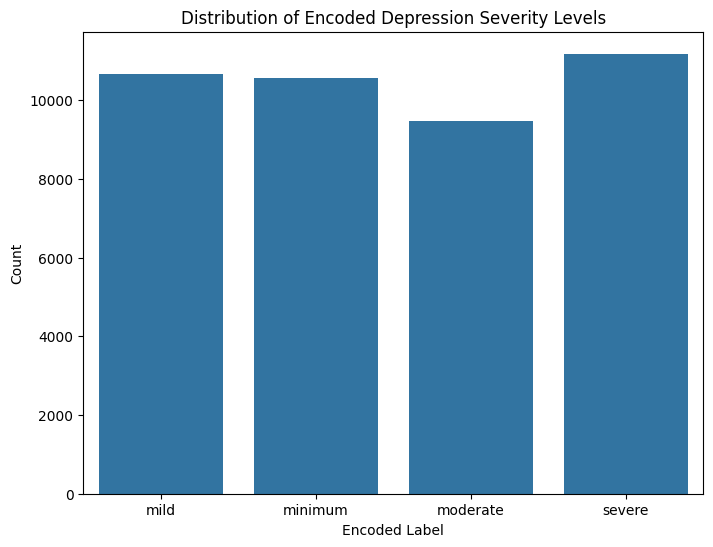

In [18]:
# Check distribution of labels
label_counts = df['label_encoded'].value_counts().sort_index()
label_mapping = dict(zip(df['label_encoded'], df['label']))

plt.figure(figsize=(8, 6))
sns.barplot(x=label_counts.index, y=label_counts.values)
plt.title('Distribution of Encoded Depression Severity Levels')
plt.xlabel('Encoded Label')
plt.ylabel('Count')
plt.xticks(ticks=label_counts.index, labels=[label_mapping.get(i, f'Label {i}') for i in label_counts.index])
plt.show()

In [117]:
# optimizer = Adam(learning_rate=0.0001)
optimizer = RMSprop(learning_rate=0.0005)

In [118]:
num_classes = len(df['label_encoded'].unique())

model = Sequential()
model.add(Embedding(VOCAB_SIZE, 128, input_length=MAX_LEN))
model.add(LSTM(64))
model.add(Dropout(0.3))
model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='softmax'))

model.compile(
    optimizer=optimizer,
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

Model: "sequential_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding_22 (Embedding)        │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_22 (LSTM)                  │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_40 (Dropout)            │ ?                      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_41 (Dropout)            │ ?                      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ ?                      │   0 (unbuilt) │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 0 (0.00 B)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 0 (0.00 B)

In [119]:
# Early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

In [120]:
# Train model
batch_size = 32
epochs = 300

model.fit(X_train, y_train,
          batch_size=batch_size,
          epochs=epochs,
          validation_data=(X_val, y_val),
          callbacks=[early_stopping]
          )

Epoch 1/300
785/785 ━━━━━━━━━━━━━━━━━━━━ 9s 10ms/step - accuracy: 0.3999 - loss: 1.2453 - val_accuracy: 0.5055 - val_loss: 0.9848
Epoch 2/300
785/785 ━━━━━━━━━━━━━━━━━━━━ 7s 9ms/step - accuracy: 0.4924 - loss: 1.0173 - val_accuracy: 0.5281 - val_loss: 0.9300
Epoch 3/300
785/785 ━━━━━━━━━━━━━━━━━━━━ 10s 9ms/step - accuracy: 0.5053 - loss: 0.9607 - val_accuracy: 0.5411 - val_loss: 0.9152
Epoch 4/300
785/785 ━━━━━━━━━━━━━━━━━━━━ 8s 10ms/step - accuracy: 0.5314 - loss: 0.9221 - val_accuracy: 0.5509 - val_loss: 0.9423
Epoch 5/300
785/785 ━━━━━━━━━━━━━━━━━━━━ 7s 9ms/step - accuracy: 0.5602 - loss: 0.8943 - val_accuracy: 0.5761 - val_loss: 0.8664
Epoch 6/300
785/785 ━━━━━━━━━━━━━━━━━━━━ 7s 9ms/step - accuracy: 0.5951 - loss: 0.8516 - val_accuracy: 0.5972 - val_loss: 0.8507
Epoch 7/300
785/785 ━━━━━━━━━━━━━━━━━━━━ 7s 9ms/step - accuracy: 0.6014 - loss: 0.8267 - val_accuracy: 0.6036 - val_loss: 0.8656
Epoch 8/300
785/785 ━━━━━━━━━━━━━━━━━━━━ 7s 9ms/step - accuracy: 0.6331 - loss: 0.7958 - val_a

In [121]:
# Evaluate model
loss, accuracy = model.evaluate(X_test, y_test)

print('Test accuracy:', accuracy)

262/262 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.6529 - loss: 0.7768
Test accuracy: 0.6453654766082764


In [122]:
# Classification report
y_pred_probs = model.predict(X_test)

# Convert probabilities to predicted class labels
y_pred = np.argmax(y_pred_probs, axis=1)

print(classification_report(y_test, y_pred, target_names=['mild', 'minimum', 'moderate', 'severe']))

262/262 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
              precision    recall  f1-score   support

        mild       0.67      0.51      0.58      2087
     minimum       0.60      0.89      0.72      2112
    moderate       0.87      0.48      0.62      1946
      severe       0.59      0.68      0.63      2227

    accuracy                           0.65      8372
   macro avg       0.68      0.64      0.64      8372
weighted avg       0.68      0.65      0.64      8372



In [123]:
model.save('ajoc-sasana-robles_final-project.keras')

In [125]:
files.download('ajoc-sasana-robles_final-project.keras')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>